# Project 4 OLIST - 02 : Clustering

In [1]:
%pylab inline
import pandas as pd
import seaborn as sns
import plotly.graph_objs as go
from pywaffle import Waffle
from sklearn.base import clone
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import silhouette_score, adjusted_rand_score
import category_encoders as ce
from sklearn.decomposition import PCA
from time import time
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import silhouette_visualizer
import operator
from sklearn import manifold
import plotly.express as px
from sklearn.mixture import GaussianMixture
import datetime as dt
from dateutil.relativedelta import relativedelta

pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 200)
plt.style.use('fivethirtyeight')

Populating the interactive namespace from numpy and matplotlib


In [2]:
%load_ext pycodestyle_magic
%flake8_on -i E501

In [3]:
db_df = pd.read_csv('POLIST_04_data/cleaned_grouped_tables.csv', sep=',')
db_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119151 entries, 0 to 119150
Data columns (total 44 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   customer_id                    119151 non-null  object 
 1   customer_unique_id             119151 non-null  object 
 2   customer_zip_code_prefix       119151 non-null  int64  
 3   customer_city                  119151 non-null  object 
 4   customer_state                 119151 non-null  object 
 5   order_id                       119151 non-null  object 
 6   order_status                   119151 non-null  object 
 7   order_purchase_timestamp       119151 non-null  object 
 8   order_approved_at              118974 non-null  object 
 9   order_delivered_carrier_date   117065 non-null  object 
 10  order_delivered_customer_date  115730 non-null  object 
 11  order_estimated_delivery_date  119151 non-null  object 
 12  delivery_time                 

## Computing final features

In [4]:
def mode_w_nan(values):
    '''
    Wrapper of the pandas mode function to handle null values
    values: pandas.Series - values in a df column
    output: type(values.dtype) - the mode of the given series
    '''
    if all(([x is np.nan for x in values])):
        return 'unknown'
    return pd.Series.mode(values)[0]  # if multiple items are returned, take the first


def compute_features(db_df):
    '''Compute the features of the final dataset, same way as the previous notebook (without correlated features and categorical features with too many unique values)
    db_df: DataFrame - Grouped tables
    output: Dataframe - Final dataset
    '''
    for col in db_df.columns:
        # dates as DateTime
        if any([sub in col for sub in ['date', '_at', 'timestamp']]):
            db_df[col] = db_df[col].astype('datetime64')
    # number of orders per customer
    df = pd.DataFrame(data={'nb_orders': db_df.groupby('customer_unique_id')['customer_id'].nunique(dropna=True)})
    # total number of products ordered per customer
    df['total_products_ordered'] = db_df.groupby(['customer_unique_id', 'order_id'])['order_item_id'].max().groupby('customer_unique_id').sum()
    # total paid
    df['total_paid'] = db_df.groupby('customer_unique_id')['price'].sum()
    # mean description length for ordered products
    # df['mean_prod_descr_length'] = db_df.groupby('customer_unique_id')['product_description_lenght'].mean()
    # mean photos qty for ordered products
    df['mean_photo_qty_for_ordered_prods'] = db_df.groupby('customer_unique_id')['product_photos_qty'].mean()
    # mean review score
    df['mean_reviews_score'] = db_df.groupby('customer_unique_id')['review_score'].mean()
    # mean review messages length
    df['mean_reviews_txt_length'] = db_df.groupby('customer_unique_id')['review_text_length'].mean()
    # first order date
    first_order_date = db_df.groupby('customer_unique_id')['order_purchase_timestamp'].min()
    # days since the last order
    df['recency'] = pd.to_timedelta(db_df['order_purchase_timestamp'].max() - first_order_date).dt.days
    # mean delivery time
    df['mean_delivery_time'] = db_df.groupby('customer_unique_id')['delivery_time'].mean(numeric_only=False)
    # mean delivery delay
    # df['mean_delivery_delay'] = db_df.groupby('customer_unique_id')['delivery_delay'].mean(numeric_only=False)
    # favorite product category
    df['favorite_category'] = db_df.groupby('customer_unique_id')['product_category_agg'].agg(mode_w_nan)
    # favorite payment type
    df['favorite_payment_type'] = db_df.groupby('customer_unique_id')['payment_type'].agg(mode_w_nan)
    # customer state
    df = df.join(db_df[['customer_unique_id', 'customer_state']].drop_duplicates(subset=['customer_unique_id']).set_index('customer_unique_id'))
    # fill null values caused when trying to divide by 0
    for col in df.columns:
        if 'mean' in col:
            df[col].fillna(0, inplace=True)
    return df

In [5]:
df = compute_features(db_df)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 96096 entries, 0000366f3b9a7992bf8c76cfdf3221e2 to ffffd2657e2aad2907e67c3e9daecbeb
Data columns (total 11 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   nb_orders                         96096 non-null  int64  
 1   total_products_ordered            96096 non-null  float64
 2   total_paid                        96096 non-null  float64
 3   mean_photo_qty_for_ordered_prods  96096 non-null  float64
 4   mean_reviews_score                96096 non-null  float64
 5   mean_reviews_txt_length           96096 non-null  float64
 6   recency                           96096 non-null  int64  
 7   mean_delivery_time                96096 non-null  float64
 8   favorite_category                 96096 non-null  object 
 9   favorite_payment_type             96096 non-null  object 
 10  customer_state                    96096 non-null  object 
dtypes: float64(6),

## RFM analysis

- Recency: Days since last order
- Frequency: Number of total order
- Monetary: Amount of total purchase value

In [6]:
def rfm_iso_scatter(data, x, y, z, color='nb_orders', reduce=True):
    '''generate a 3D scatter plot
    Input:
    - dat : dataframe
    - x, y, z : str - 3 features name for the three coordinates
    '''
    if reduce:
        x = data[x]
        y = data[data[y] < 10][y]
        z = data[data[z] < 4000][z]
    else:
        x = data[x]
        y = data[y]
        z = data[z]

    fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='markers', marker=dict(size=1, color=data[color], colorscale='thermal', opacity=0.8))])

    fig.update_layout(scene=dict(
        xaxis_title='Recency',
        yaxis_title='Frequency',
        zaxis_title='Monetary'),
        width=800,
        margin=dict(r=20, b=10, l=10, t=10))
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    fig.show()

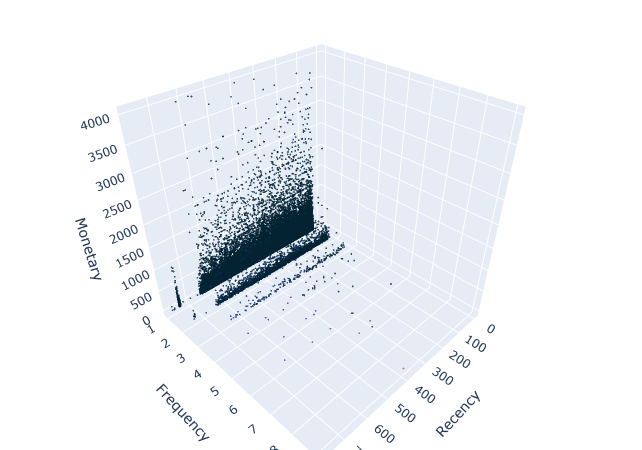

In [7]:
rfm_iso_scatter(df, 'recency', 'nb_orders', 'total_paid')

**By printing a 3d scatter plot for the three features (Recency, Frequency, Monetary) a clearly visible clustering can not be seen.** (the color is related to the frequency)

In [8]:
df_rfm = df.copy()

In [9]:
df_rfm['nb_orders'].unique()

array([ 1,  2,  3,  4,  6,  7,  5,  9, 17], dtype=int64)

- R(i) scores :
    - 1: Recency(i) ≥ Q3 of total Time period
    - 2: Recency(i) ≥ Q2 of total Time period < Q3 of total Time period
    - 3: Recency(i) ≥ Q1 of total Time period < Q2 of total Time period
    - 4: Recency(i) < Q1 of total Time period  
- F(i) scores :
    - 1: Frequency(i) < 2
    - 2: Frequency(i) ≥ 2 & Frequency(i) < 4 
    - 3: Frequency(i) ≥ 4 & Frequency(i) < 7 
    - 4: Frequency(i) ≥ 7  
- M(i) scores :
    - 1: Monetary(i) ≥ Q3 of total range of purchases
    - 2: Monetary(i) ≥ Q2 of total range of purchases < Q3 of total range of purchases
    - 3: Monetary(i) ≥ Q1 of total range of purchases < Q2 of total range of purchases
    - 4: Monetary(i) < Q1 of total range of purchases  

In [10]:
def assign_frequency(x):
    '''
    Function to assign frequency score
    Input:
    x: int - nb orders
    Output: int - frequency score
    '''
    if x >= 7:
        return 4
    elif x >= 4:
        return 3
    elif x >= 2:
        return 2
    else:
        return 1

In [11]:
df_rfm['R'] = pd.qcut(df_rfm['recency'], q=4, labels=range(4, 0, -1))
df_rfm['F'] = df_rfm['nb_orders'].apply(assign_frequency)
df_rfm['M'] = pd.qcut(df['total_paid'], q=4, labels=range(1, 5))
df_rfm.head()

,nb_orders,total_products_ordered,total_paid,mean_photo_qty_for_ordered_prods,mean_reviews_score,mean_reviews_txt_length,recency,mean_delivery_time,favorite_category,favorite_payment_type,customer_state,R,F,M
customer_unique_id,,,,,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,1,1.0,129.90,1.0,5.0,126.0,160,6.0,home,credit_card,sp,4,1,3
0000b849f77a49e4a4ce2b2a4ca5be3f,1,1.0,18.90,1.0,4.0,0.0,163,3.0,health_beauty,credit_card,sp,4,1,1
0000f46a3911fa3c0805444483337064,1,1.0,69.00,3.0,3.0,0.0,585,25.0,office,credit_card,sc,1,1,2
0000f6ccb0745a6a4b88665a16c9f078,1,1.0,25.99,5.0,4.0,12.0,369,20.0,electronics,credit_card,pa,2,1,1
0004aac84e0df4da2b147fca70cf8255,1,1.0,180.00,3.0,5.0,0.0,336,13.0,electronics,credit_card,sp,2,1,4


In [12]:
df_rfm['segment_RFM'] = df_rfm['R'].astype(str) + df_rfm['F'].astype(str) + df_rfm['M'].astype(str)
df_rfm['score_rfm'] = df_rfm[['R', 'F', 'M']].sum(axis=1)

In [13]:
def rfm_assiner(df):
    '''
    Function to assign RFM classes according conditions.
    Input:
    df : dataframe - containing RFM score and RFM segment key
    Output: str - segment class
    '''
    if (int(df['segment_RFM']) >= 434) or (df['score_rfm'] >= 9):
        return 'Best customer'
    elif (df['score_rfm'] >= 8) and (df['M'] == 4):
        return 'Big Spender'
    elif (df['score_rfm'] >= 6) and (df['F'] >= 2):
        return 'Loyalist'
    elif (int(df['segment_RFM']) >= 231) or (df['score_rfm'] >= 6):
        return 'Potential Loyalists'
    elif ((int(df['segment_RFM']) >= 121) and (df['R'] == 1)) or df['score_rfm'] == 5:
        return 'Almost Lost'
    elif (df['score_rfm'] >= 4) and (df['R'] == 1):
        return 'Hibernating'
    else:
        return 'Lost Customer'

In [14]:
# Defining RFM with the appropriate approach suggestion
dict_rfm_tiers = {
    'Best customer': 'Personalized communication, offer loyalty program, no promotional offers needed',
    'Big Spender': 'Make them feel valued and offer quality products, encourage to stick with brands',
    'Loyalist': 'Offer loyalty program',
    'Potential Loyalists': 'Recommend products and offer discounts',
    'Almost Lost': 'Try to win them with limited sales promotions',
    'Hibernating': 'Make great offers with big discounts',
    'Lost Customer': 'Do not spent much effort and money to win them'
}

In [15]:
df_rfm['customer_rfm_segment'] = df_rfm.apply(rfm_assiner, axis=1)
df_rfm['marketing_approach'] = df_rfm['customer_rfm_segment'].apply(lambda x: dict_rfm_tiers[x])

In [16]:
df_recap_rfm = df_rfm.reset_index().groupby('customer_rfm_segment').agg(
    Count=('customer_unique_id', 'count'),
    Recency=('recency', 'mean'),
    Frequency=('nb_orders', 'mean'),
    Monetary=('total_paid', 'mean'),
    Strategy=('marketing_approach', 'unique'),
).round(1)
df_recap_rfm

,Count,Recency,Frequency,Monetary,Strategy
customer_rfm_segment,,,,,
Almost Lost,11609,411.6,1.0,90.5,[Try to win them with limited sales promotions]
Best customer,6233,118.0,1.1,388.3,"[Personalized communication, offer loyalty pro..."
Big Spender,5935,228.7,1.1,368.6,[Make them feel valued and offer quality produ...
Hibernating,6085,499.9,1.0,66.9,[Make great offers with big discounts]
Lost Customer,11787,421.8,1.0,27.9,[Do not spent much effort and money to win them]
Loyalist,1589,415.9,2.1,241.1,[Offer loyalty program]
Potential Loyalists,52858,234.0,1.0,141.9,[Recommend products and offer discounts]


In [17]:
def plot_waffle_chart(data, metric, agg, title_txt, group='sub_segment'):
    '''
    Funtion to create a waffle chart. The visualization shows how the
    customer sub-segments are distributed according defined metrics.
    Input:
    - dat - dataframe
    - metric - feature/ kpi metric to visualize
    - agg - method to aggregate
    - title_txt - text to display as chart title
    Outout:
    - waffle chart
    '''
    data_revenue = dict(round(data.groupby(group).agg({metric: agg}))[metric])

    plt.figure(
        FigureClass=Waffle,
        rows=5,
        columns=10,
        values=data_revenue,
        labels=[f"{k, v}" for k, v in data_revenue.items()],
        legend={'loc': 'lower left', 'bbox_to_anchor': (1, 0)},
        figsize=(15, 5))

    plt.title(title_txt)

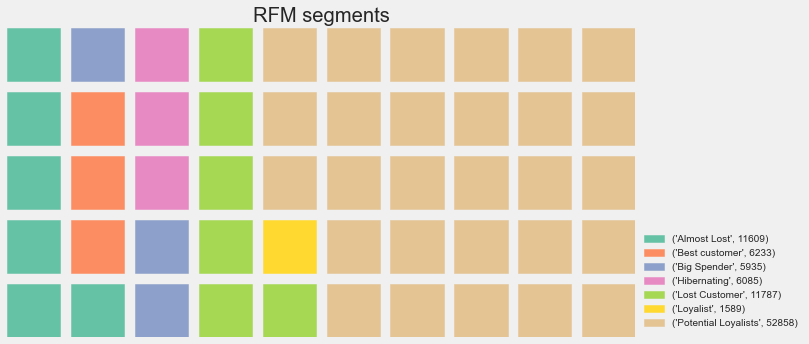

In [18]:
plot_waffle_chart(df_rfm.reset_index(), 'customer_unique_id', 'count', 'RFM segments', 'customer_rfm_segment')

- The order frequency and order amounts are concentrated on the lower end. This is what we have repeatedly have seen before.
- The biggest RFM segment is the group of Potential Loyalists. These customers needs to be targeted with offers and discounts in order to make the business successful.
- There is a good base of Big Spenders and Best Customers, which is good news for the business.
- Some effort needs to be spent to target hibernating customers and customers which are almost lost

## K-means

### All features

#### Preprocessing

##### Encoding & scaling

In [19]:
categorical_cols = df.columns[df.dtypes == object].tolist()

preprocessor = Pipeline([
    ('encoding', ce.OneHotEncoder(cols=categorical_cols)),
    ('features_scaling', MinMaxScaler())  # MinMaxScaler because the shape of all features do not follows a normal distribution
])


In [20]:
data_scaled = preprocessor['encoding'].fit_transform(df)

##### PCA

In [21]:
n_components = min(data_scaled.shape[0], data_scaled.shape[1])
# addind a PCA step in the preprocessor pipeline
preprocessor.steps.append(['pca', PCA(n_components=n_components, random_state=0)])

In [22]:
preprocessor.fit(df)

Pipeline(steps=[('encoding',
                 OneHotEncoder(cols=['favorite_category',
                                     'favorite_payment_type',
                                     'customer_state'])),
                ('features_scaling', MinMaxScaler()),
                ['pca', PCA(n_components=53, random_state=0)]])

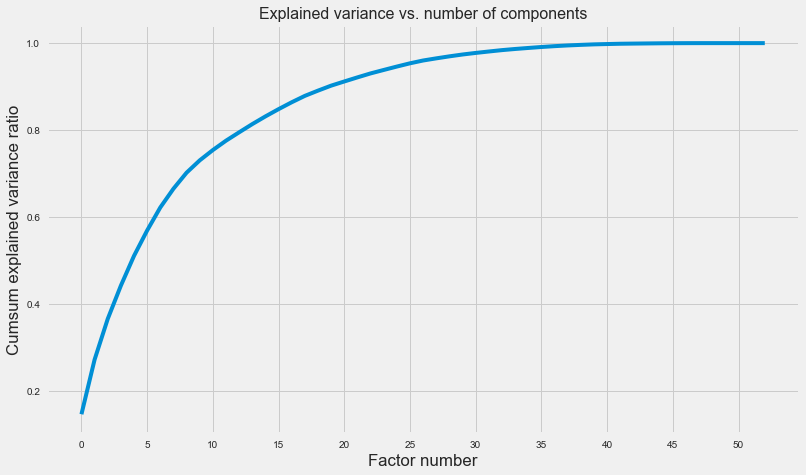

In [23]:
fig, ax = plt.subplots(figsize=(12, 7))
plt.plot(np.arange(0, n_components), preprocessor['pca'].explained_variance_ratio_.cumsum())
plt.title("Explained variance vs. number of components", fontsize=16)
plt.ylabel("Cumsum explained variance ratio")
plt.xlabel("Factor number")
plt.xticks(range(0, n_components+1, 5))
plt.show()

More than 95% of the data variance is explained with 30 components

In [24]:
preprocessor['pca'].n_components = 30

In [25]:
data_pca = preprocessor.fit_transform(df)
data_pca.shape

(96096, 30)

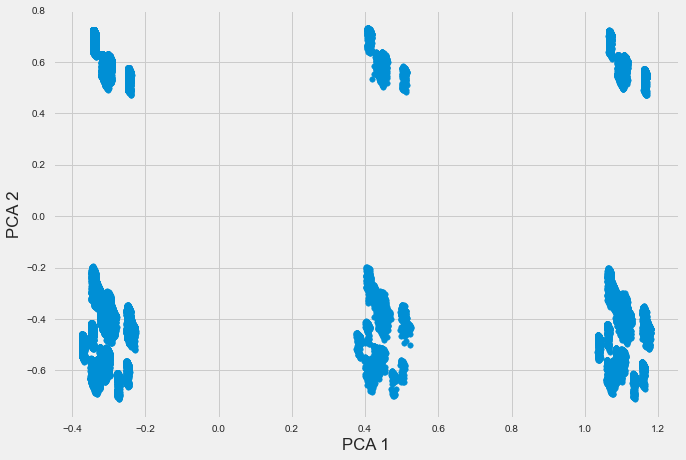

In [26]:
# Using 2 first components of the PCA
plt.figure(figsize=(10, 7))
plt.scatter(data_pca[:, 0], data_pca[:, 1], s=30)
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.show()

#### Optimal number of clusters

In [27]:
kmeans_params = {
    'n_clusters': 8,  # number of clusters (default value)
    'init': 'k-means++',  # initialization technique
    'n_init': 10,  # number of initializations to perform (default value)
    'max_iter': 300,  # number of maximum iterations for each initialization (default value)
    'random_state': 1
}

kmeans_pipe = Pipeline([
    ('preprocessor', preprocessor),
    ('clusterer', KMeans(**kmeans_params))
])


def display_kmeans_results(pipeline, data):
    '''Print the results of the given pipeline on the given data
    pipeline: Pipeline - Contain the preprocessing and the model
    data: DataFrame - initial dataset
    '''
    t0 = time()
    pipeline.fit(data)
    fit_time = time() - t0

    results = [kmeans_pipe['clusterer'].init, fit_time, kmeans_pipe['clusterer'].n_iter_, kmeans_pipe['clusterer'].inertia_]

    kmeans_data_pca = kmeans_pipe['preprocessor'].transform(df)
    kmeans_pred_labels = kmeans_pipe['clusterer'].labels_

    results += [silhouette_score(kmeans_data_pca, kmeans_pred_labels, metric='euclidean')]
    print('init\t\ttime\tnb_iter\tinertia\tsilhouette')
    print("{:9s}\t{:.3f}s\t{}\t{:.0f}\t{:.3f}".format(*results))

In [28]:
display_kmeans_results(kmeans_pipe, df)

init		time	nb_iter	inertia	silhouette
k-means++	4.779s	7	121189	0.198


**Elbow method**

In [29]:
def display_elbow_visu(pipeline, data, k_range, metric, elbow=True):
    '''Display a Silhouette plot for each nummber of clusters in k_range
    input:
        pipeline: Pipeline - contain preprocessing and model
        data: dataframe - inital dataset
        k_range: tuple - range of n_cluster to test
        metric: str - used metric
    '''
    pipeline.fit(data)
    (fig, ax) = plt.subplots(figsize=(10, 7))
    visualizer_WCSS = KElbowVisualizer(clone(pipeline['clusterer']), k=k_range, metric=metric, locate_elbow=elbow, ax=ax)
    visualizer_WCSS.fit(pipeline['preprocessor'].fit_transform(data))
    visualizer_WCSS.show()

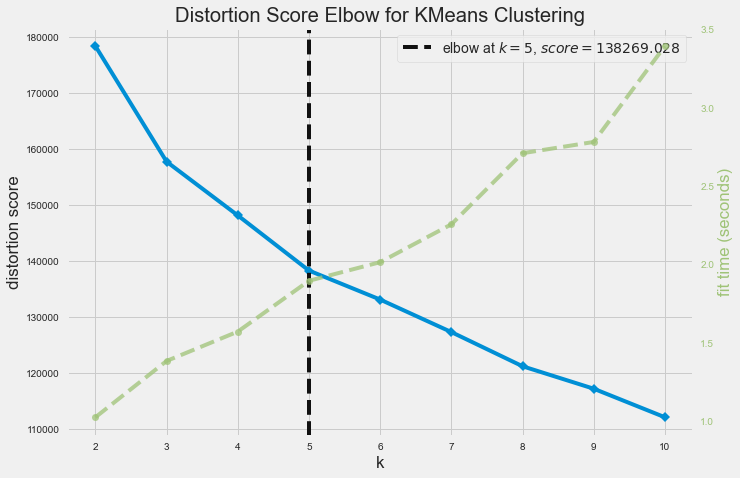

In [30]:
k_range = (2, 11)
display_elbow_visu(kmeans_pipe, df, k_range, 'distortion')

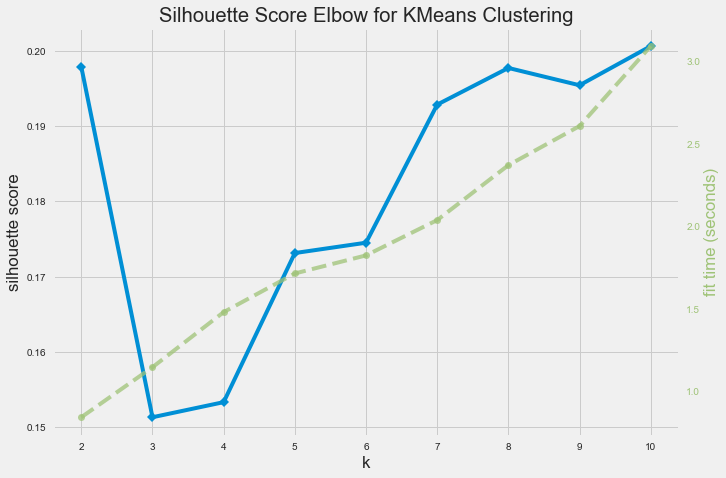

Wall time: 17min 34s


In [31]:
%%time
display_elbow_visu(kmeans_pipe, df, k_range, 'silhouette', elbow=False)

**Silouhette analysis**

In [32]:
def silouhette_analysis(pipeline, data, k_range):
    '''Display a Silhouette plot for each nummber of clusters in k_range
    input:
        pipeline: Pipeline - contain preprocessing and model
        data: dataframe - inital dataset
        k_range: tuple - range of n_cluster to test
    output: dict with number of clusters as index and average silhouette score as value
    '''
    scores_dict = {}
    for i in range(k_range[0], k_range[1]):
        pipeline['clusterer'].n_clusters = i
        (fig, ax) = plt.subplots()
        visu = silhouette_visualizer(clone(pipeline['clusterer']), pipeline['preprocessor'].fit_transform(data), colors='yellowbrick', ax=ax)
        scores_dict[i] = visu.silhouette_score_  # index = number of clusters / value = silouette score
    for item in scores_dict:
        print('{} clusters - Average silhouette score : {}'.format(item, scores_dict[item]))
    return scores_dict

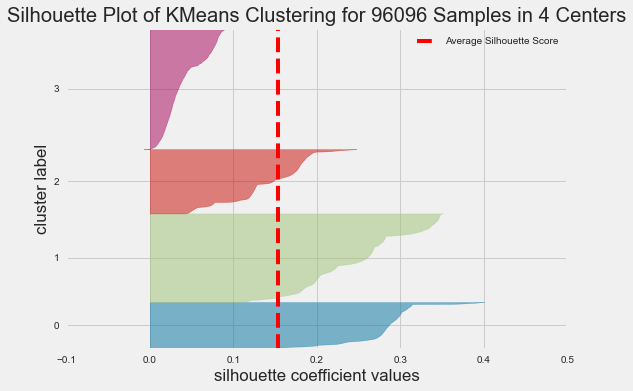

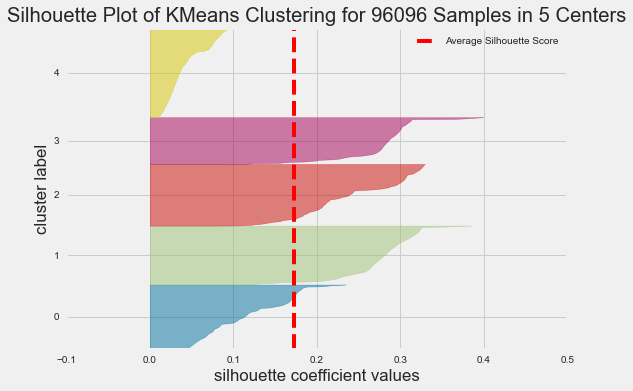

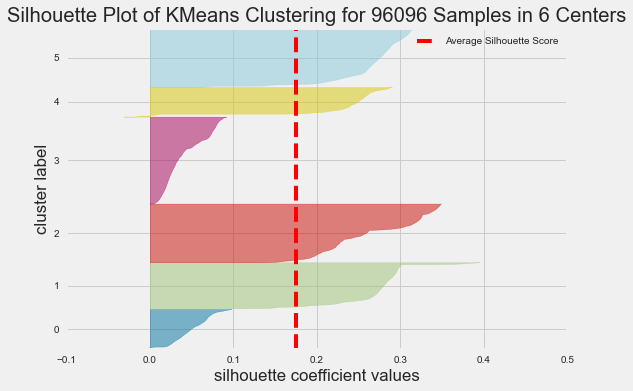

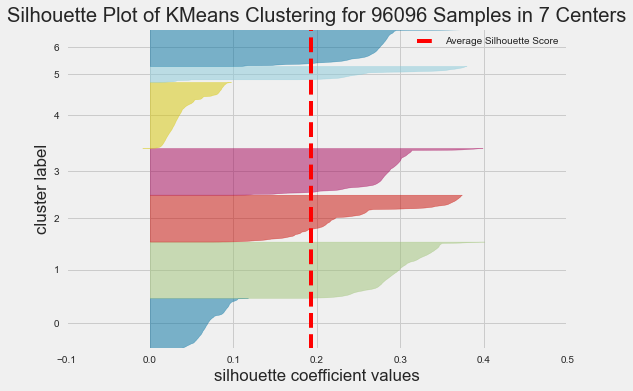

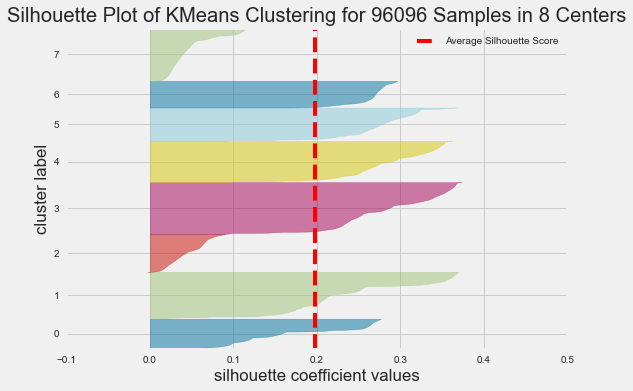

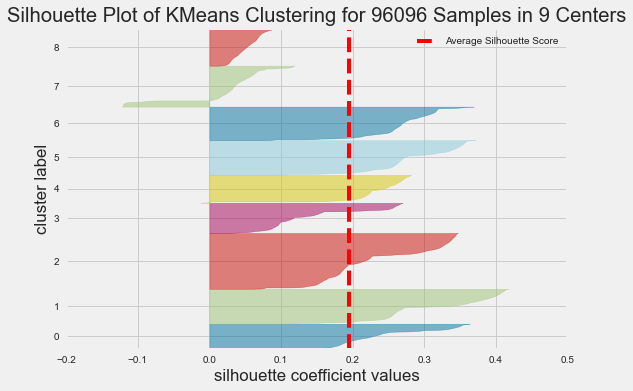

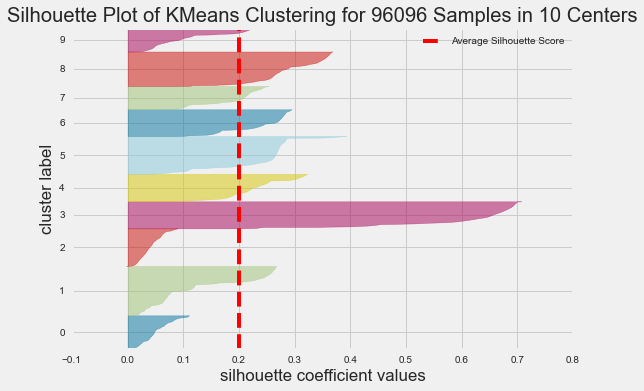

4 clusters - Average silhouette score : 0.1532900038264689
5 clusters - Average silhouette score : 0.17311931565706415
6 clusters - Average silhouette score : 0.17449408783528939
7 clusters - Average silhouette score : 0.19286082102536292
8 clusters - Average silhouette score : 0.19773407641884208
9 clusters - Average silhouette score : 0.19543367556261226
10 clusters - Average silhouette score : 0.20063901314749572
Wall time: 25min 16s


In [33]:
%%time
scores = silouhette_analysis(kmeans_pipe, df, (4, 11))

- There is always at least 1 cluster very close to the others
- When there are **5 clusters**, the data is more well distributed between each clusters

In [34]:
best_sil_score = max(scores.items(), key=operator.itemgetter(1))[0]
print('Best average silhouette score : {} clusters ({:.4})'.format(best_sil_score, scores[best_sil_score]))

Best average silhouette score : 10 clusters (0.2006)


In [35]:
# set the number of clusters which produce the best average silouhette score
kmeans_pipe['clusterer'].n_clusters = 5

#### Visualizations

**PCA reduced data**

In [36]:
def visualize_kmeans_clustering(pipeline, data, pca=False):
    '''Visualize the kmeans clustering results on PCA-reduced data
    parameters:
        pipeline : Pipeline - The pipeline containing the preprocessing and the clustering model
        data : DataFrame - Preprocessed data
    '''
    reduced_data = pipeline['preprocessor'].fit_transform(data)
    if pca:
        reduced_data = PCA(n_components=2).fit_transform(reduced_data)
    pipeline['clusterer'].fit(reduced_data[:, :2])

    # Step size of the mesh. Decrease to increase the quality of the VQ.
    h = .02   # point in the mesh [x_min, x_max]x[y_min, y_max].

    # Plot the decision boundary. For that, we will assign a color to each
    x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
    y_min, y_max = reduced_data[:, 1].min() - 1, reduced_data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # Obtain labels for each point in mesh.
    Z = pipeline['clusterer'].predict(np.c_[xx.ravel(), yy.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    plt.figure(1, figsize=(15, 12))
    plt.clf()
    plt.imshow(Z, interpolation="nearest",
               extent=(xx.min(), xx.max(), yy.min(), yy.max()),
               cmap=plt.cm.Paired, aspect="auto", origin="lower")

    plt.plot(reduced_data[:, 0], reduced_data[:, 1], 'k.', markersize=2)
    # Plot the centroids as a white X
    centroids = pipeline['clusterer'].cluster_centers_
    plt.scatter(centroids[:, 0], centroids[:, 1], marker="x", s=50, linewidths=2, color="w", zorder=10)
    plt.title("K-means clustering on the OLIST dataset (PCA-Reduced)\nWith {} clusters".format(pipeline['clusterer'].n_clusters))
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xticks(())
    plt.yticks(())
    plt.show()

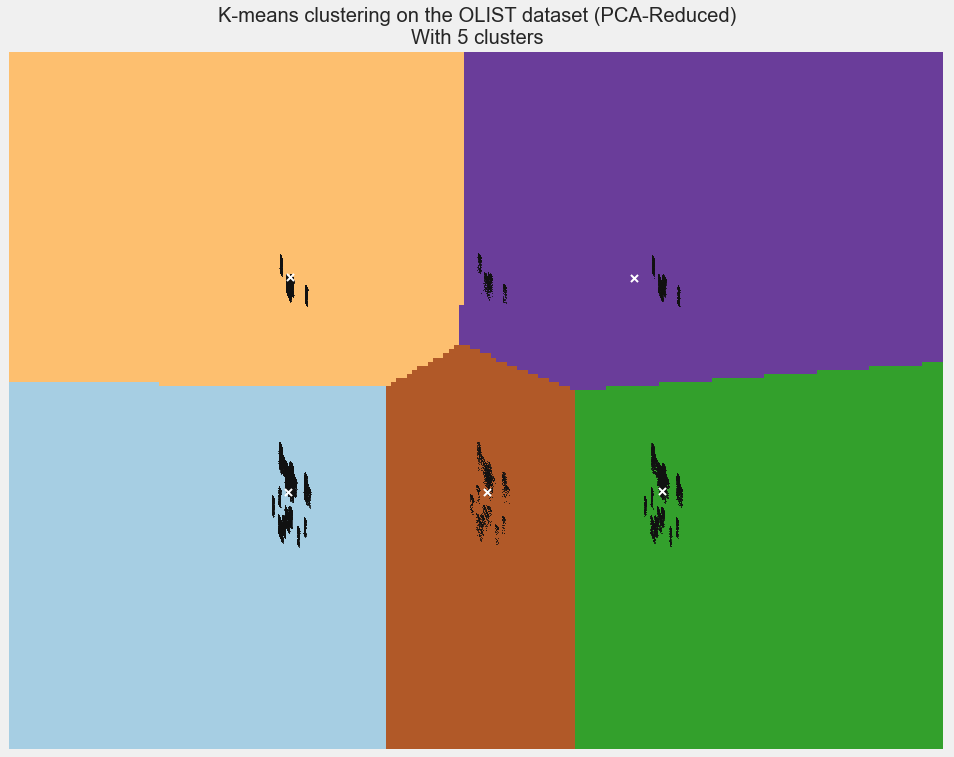

In [37]:
visualize_kmeans_clustering(kmeans_pipe, df)

**T-SNE**

In [38]:
tsne_params = {
    'n_components': 2,
    'init': 'pca',
    'perplexity': 5,
    'n_iter': 1000,
    'n_iter_without_progress': 300,
    'learning_rate': 200.,
    'n_jobs': -1,
    'random_state': 0
}


def tsne_visualization(data, predicted_labels, tsne_params):
    '''Produce a dimension reduction with T-SNE algo to visualize the clustering
    kmeans_pipe: Pipeline - Pipeline containng the preprocessing and the kmeans model
    data: DataFrame - Preprocessed dataset (PCA30 reduced)
    predicted_labels: list - list of predicted labels
    tsne_params : dict - tSNE Parameters
    '''
    tsne = manifold.TSNE(**tsne_params)
    tsne_result = tsne.fit_transform(data)
    df_tsne = pd.DataFrame(tsne_result, columns=['tsne_1', 'tsne_2'])
    df_tsne['predicted_labels'] = predicted_labels
    plt.figure(figsize=(15, 12))
    sns.scatterplot(
        x='tsne_1', y='tsne_2',
        hue='predicted_labels',
        palette=sns.color_palette("hls", df_tsne['predicted_labels'].nunique()),
        data=df_tsne,
        legend="full",
        alpha=0.4)

Wall time: 7min 53s


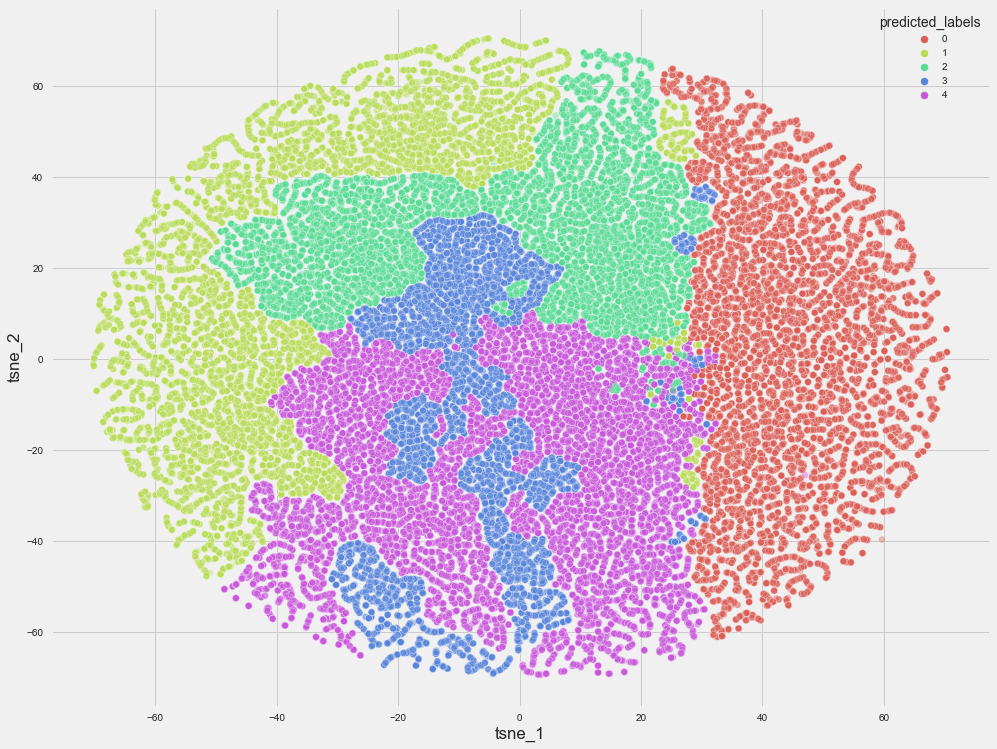

In [39]:
%%time
kmeans_pipe.fit(df)
tsne_visualization(kmeans_pipe['preprocessor'].transform(df), kmeans_pipe['clusterer'].labels_, tsne_params)

#### Clusters interpretation

In [40]:
# add predicted labels to the inital dataset
kmeans_pipe.fit(df)
df_labels = df.copy()
df_labels['predicted_label'] = kmeans_pipe['clusterer'].labels_

In [41]:
def clustering_interpretations(df, min_max=(0, 100)):
    '''Produces a radar graph to analyze each cluster
    df: DataFrame -  initial DataFrame with predicted labels
    '''
    grouped_df = df.groupby('predicted_label').mean()
    scaler = MinMaxScaler(min_max)
    scaled_df = pd.DataFrame(scaler.fit_transform(grouped_df), columns=grouped_df.columns)
    scores = []
    for cluster, row in scaled_df.iterrows():
        print(row)
        scores.append(row)
        fig = px.line_polar(row, r=row.values, theta=row.index, line_close=True, title='Cluster {}'.format(cluster))
        fig.update_traces(fill='toself')
        fig.show()
    return pd.DataFrame(scores)

nb_orders                           78.258424
total_products_ordered              52.428452
total_paid                           0.000000
mean_photo_qty_for_ordered_prods    47.107683
mean_reviews_score                  43.714087
mean_reviews_txt_length             41.888590
recency                             79.075665
mean_delivery_time                  74.942299
Name: 0, dtype: float64


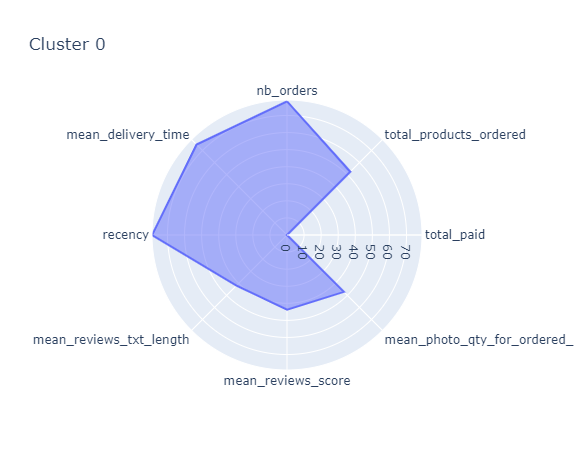

nb_orders                           100.000000
total_products_ordered              100.000000
total_paid                            8.560431
mean_photo_qty_for_ordered_prods      0.000000
mean_reviews_score                   13.897712
mean_reviews_txt_length              74.919859
recency                              61.855732
mean_delivery_time                   59.874709
Name: 1, dtype: float64


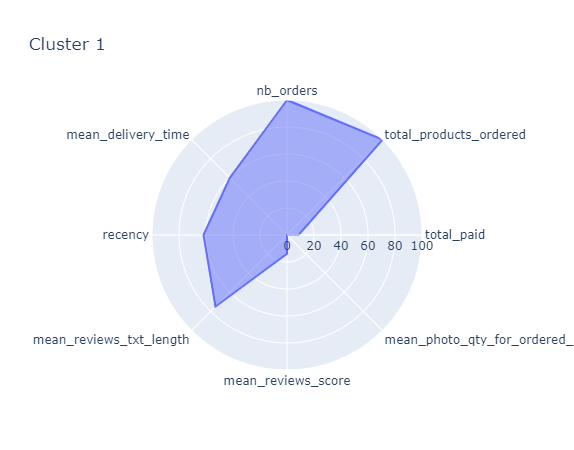

nb_orders                           56.085307
total_products_ordered              19.478288
total_paid                          41.552323
mean_photo_qty_for_ordered_prods    37.665687
mean_reviews_score                  89.678238
mean_reviews_txt_length             35.605035
recency                              0.000000
mean_delivery_time                   0.000000
Name: 2, dtype: float64


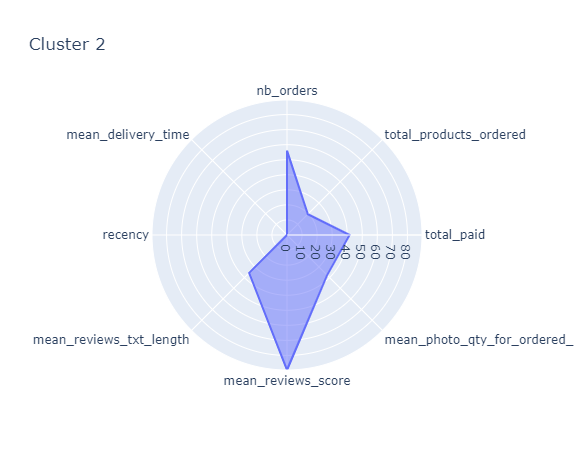

nb_orders                             0.000000
total_products_ordered                0.000000
total_paid                           66.452486
mean_photo_qty_for_ordered_prods    100.000000
mean_reviews_score                  100.000000
mean_reviews_txt_length               0.000000
recency                             100.000000
mean_delivery_time                   51.610609
Name: 3, dtype: float64


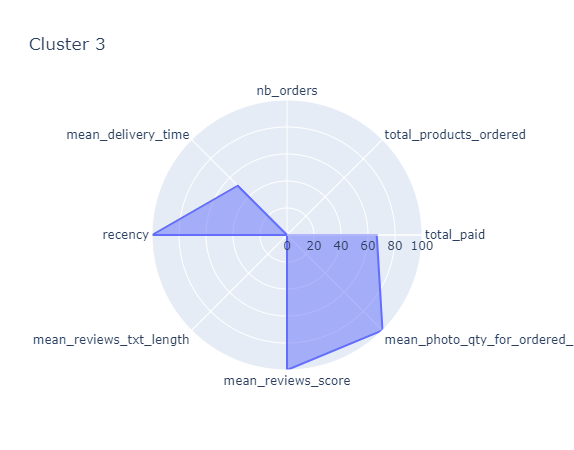

nb_orders                            11.088971
total_products_ordered               10.499332
total_paid                          100.000000
mean_photo_qty_for_ordered_prods     48.955265
mean_reviews_score                    0.000000
mean_reviews_txt_length             100.000000
recency                              46.188598
mean_delivery_time                  100.000000
Name: 4, dtype: float64


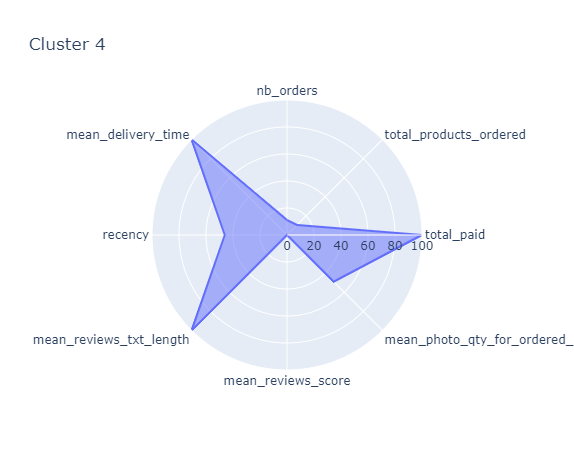

In [42]:
clusters_descr = clustering_interpretations(df_labels)

Interpretation :  
- 0: several inexpensive orders, not happy (bad scores + long reviews)
- 1: loyalists, low spenders
- 2: happy clients, potential loyalist
- 3: Good clients, spend more than average, good reviws scores, not very loyal, attentive to the products photos
- 4: Best clients, high spenders, long reviews, not affraid of long delivery time

In [43]:
clusters_label = {
    0: 'several inexpensive orders, not happy (bad scores + long reviews)',
    1: 'loyalists, low spenders',
    2: 'happy clients, potential loyalist',
    3: 'Good clients, spend more than average, good reviws scores, not very loyal, attentive to the products photos',
    4: 'high spenders, long reviews, not affraid of delivery time'
}
df_labels['cluster_interpretation'] = df_labels['predicted_label'].apply(lambda x: clusters_label[x])

In [44]:
df_recap_kmeans = df_labels.reset_index().groupby('predicted_label').agg(
    Count=('customer_unique_id', 'count'),
    Orders=('nb_orders', 'mean'),
    Products=('total_products_ordered', 'mean'),
    PhotosQty=('mean_photo_qty_for_ordered_prods', 'mean'),
    ReviewsScore=('mean_reviews_score', 'mean'),
    RewiewsLength=('mean_reviews_txt_length', 'mean'),
    Recency=('recency', 'mean'),
    DeliveryTime=('mean_delivery_time', 'mean'),
    ClusterInterpretation=('cluster_interpretation', 'unique')
).round(1)
df_recap_kmeans

,Count,Orders,Products,PhotosQty,ReviewsScore,RewiewsLength,Recency,DeliveryTime,ClusterInterpretation
predicted_label,,,,,,,,,
0,19255,1.0,1.2,2.2,4.1,30.1,300.0,12.7,"[several inexpensive orders, not happy (bad sc..."
1,17661,1.0,1.3,2.1,4.0,31.5,293.3,11.7,"[loyalists, low spenders]"
2,18474,1.0,1.1,2.2,4.2,29.8,269.1,7.7,"[happy clients, potential loyalist]"
3,13987,1.0,1.1,2.4,4.2,28.3,308.2,11.1,"[Good clients, spend more than average, good r..."
4,26719,1.0,1.1,2.2,4.0,32.6,287.2,14.3,"[Best clients, high spenders, long reviews, no..."


#### Initialization stability

In [45]:
def test_init_stability(pipeline, data, nb_tests):
    '''Fit multiple times a Kmeans model on the preprocessed data, compute the ARI score with the inital predicted labels
    Params :
        pipeline : Pipeline - contains the preprocessing + the model
        data: DataFrame - Initial DataFrame
        nb_tests: int - Number of tests
    outputs: dict - contains all tested models and their ari score
    '''
    # unfix random_state
    if pipeline['clusterer'].random_state:
        pipeline['clusterer'].random_state = None

    # baseline model
    pipeline.fit(data)
    ref_labels = pipeline['clusterer'].labels_

    tested_models_dict = {}
    for i in range(1, nb_tests+1):
        current_test = {}
        pipeline.fit(data)
        # store current test model
        current_test['model'] = pipeline['clusterer']
        # store ari score
        current_test['ari_score'] = adjusted_rand_score(ref_labels, current_test['model'].labels_)
        # store current test in the dict to return
        tested_models_dict[i] = current_test
        print('Test {} - ARI : {}'.format(i, current_test['ari_score']))
    return tested_models_dict

In [46]:
tested_models = test_init_stability(kmeans_pipe, df, 20)

Test 1 - ARI : 0.6627181751845104
Test 2 - ARI : 0.6627181751845104
Test 3 - ARI : 0.36738951330957037
Test 4 - ARI : 0.5741040356454503
Test 5 - ARI : 0.36738951330957037
Test 6 - ARI : 0.6627181751845104
Test 7 - ARI : 0.6627181751845104
Test 8 - ARI : 0.4003245189916065
Test 9 - ARI : 0.7146024986011531
Test 10 - ARI : 0.6825494116383913
Test 11 - ARI : 0.7146024986011531
Test 12 - ARI : 0.6825494116383913
Test 13 - ARI : 0.7146024986011531
Test 14 - ARI : 0.36738951330957037
Test 15 - ARI : 1.0
Test 16 - ARI : 0.6627181751845104
Test 17 - ARI : 0.6627181751845104
Test 18 - ARI : 0.4837793708328677
Test 19 - ARI : 0.6627181751845104
Test 20 - ARI : 0.6627181751845104


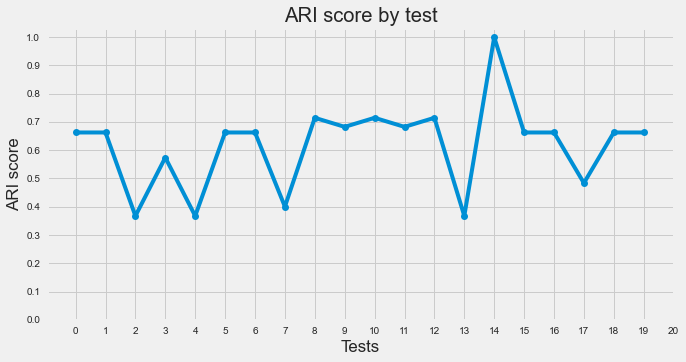

In [47]:
f, ax = plt.subplots(figsize=(10, 5))
ax.plot(np.arange(0, len(tested_models)), [tested_models[x]['ari_score'] for x in tested_models], marker='o')
ax.set_title('ARI score by test')
ax.set_xlabel('Tests')
ax.set_ylabel('ARI score')
ax.set_xticks(np.arange(0, len(tested_models)+1, 1))
ax.set_yticks(np.arange(0, 1.1, 0.1))
plt.show()

In [48]:
print('Average ARI :', sum([tested_models[x]['ari_score'] for x in tested_models]) / len(tested_models))

Average ARI : 0.6185514092977481


We can see that the model has a stability problem because about 25% of clients change cluster after each training

#### Temporal stability

In [49]:
min_date = pd.to_datetime(db_df['order_purchase_timestamp'].min()).to_pydatetime()
max_date = pd.to_datetime(db_df['order_purchase_timestamp'].max()).to_pydatetime()
print('The dataset contain data from {} to {}'.format(min_date.strftime('%Y-%m-%d'), max_date.strftime('%Y-%m-%d')))

The dataset contain data from 2016-09-04 to 2018-10-17


In [50]:
def test_temporal_stability(pipeline, db_df, begin_at=None, random_state=None, rfm=False):
    '''Create a reference model with the data from the first year and
    for each additional month until the end, create another model
    and calculate the ARI score between the predicted labels of the benchmark model and all other predicted labels
    Params:
        pipeline: Pipeline - Kmeans pipeline containing the preprocessing and the model with correct params
        grouped_tables_data: DataFrame - dataset of grouped tables
        begin_at: datetime - If provided, use it to exclude the data before
        random_state: int - Fix the random_state of the model with the value provided
        rfm: bool - If True, use only the 3 RFM features
    output: dict - Contains all trained models and their associated ARI score with the number of additionnal month as key (+ the ref model with 'ref' as key)
    '''
    final_dict = {}  # To store models and scores
    data = db_df.copy()

    # fix a random_state to help
    if not pipeline['clusterer'].random_state and random_state:
        pipeline['clusterer'].random_state = random_state

    if begin_at:
        min_date = pd.to_datetime(begin_at)
    min_date = pd.to_datetime(data['order_purchase_timestamp'].min()).to_pydatetime()
    max_date = pd.to_datetime(data['order_purchase_timestamp'].max()).to_pydatetime()
    limit = min_date + relativedelta(years=+1)

    # get the first year of data
    ref_data = data[(data['order_purchase_timestamp'] >= min_date) & (data['order_purchase_timestamp'] < limit)]
    # compute all features
    ref_data = compute_features(ref_data.copy())
    # store the unique ids of the ref customers
    ref_cust_ids = ref_data.index
    if rfm:
        ref_data = ref_data[['recency', 'nb_orders', 'total_paid']]

    # ref model
    pipeline.fit(ref_data)
    final_dict['ref'] = pipeline['clusterer']
    ref_data_pca = pipeline['preprocessor'].transform(ref_data)
    ref_model_labels = pipeline['clusterer'].labels_
    print('Ref data: {} rows'.format(ref_data.shape[0]))

    # Adds data of additional months until the end and train a model each time
    i = 1  # test number
    while limit < max_date:
        # increase limit by 1 month (placed here to get all data even if the last month is not complete)
        limit += relativedelta(months=+1)
        # get data from the min date to the limit date
        cur_data = data[(data['order_purchase_timestamp'] >= min_date) & (data['order_purchase_timestamp'] < limit)]
        cur_data = compute_features(cur_data.copy())
        if rfm:
            cur_data = cur_data[['recency', 'nb_orders', 'total_paid']]
        cur_cust_nb = cur_data.shape[0]
        # fit model on all current data
        pipeline.fit(cur_data)
        # get rid of customers not in the ref model
        cur_data = cur_data[cur_data.index.isin(ref_cust_ids)]
        # predict labels of clients in the ref model (with their data updated)
        cur_model_labels = pipeline.predict(cur_data)
        # store current model
        final_dict[i] = {'model': pipeline['clusterer']}
        # predict labels for customers in ref data
        cur_model_labels = pipeline['clusterer'].predict(ref_data_pca)
        # compute ARI score
        final_dict[i]['ari_score'] = adjusted_rand_score(ref_model_labels, cur_model_labels)
        print('Ref data + {} months ({} rows): ARI = {} '.format(i, cur_cust_nb, final_dict[i]['ari_score']))
        i += 1

    return final_dict

In [51]:
temp_stab_dict = test_temporal_stability(kmeans_pipe, db_df, random_state=1)

Ref data: 23138 rows
Ref data + 1 months (27351 rows): ARI = 1.0 
Ref data + 2 months (31696 rows): ARI = 0.9044522992444782 
Ref data + 3 months (39503 rows): ARI = 0.7620075764432553 
Ref data + 4 months (44731 rows): ARI = 0.9023320634084323 
Ref data + 5 months (51820 rows): ARI = 0.7990649718001928 
Ref data + 6 months (58414 rows): ARI = 0.8037592949190807 
Ref data + 7 months (65411 rows): ARI = 0.7788698354605345 
Ref data + 8 months (72234 rows): ARI = 0.5663368491607687 
Ref data + 9 months (78486 rows): ARI = 0.7615131250168966 
Ref data + 10 months (84520 rows): ARI = 0.9090106452269385 
Ref data + 11 months (90911 rows): ARI = 0.6015274068896317 
Ref data + 12 months (96091 rows): ARI = 0.7718189961667664 
Ref data + 13 months (96095 rows): ARI = 0.5944400560454401 
Ref data + 14 months (96096 rows): ARI = 0.5937855399931645 


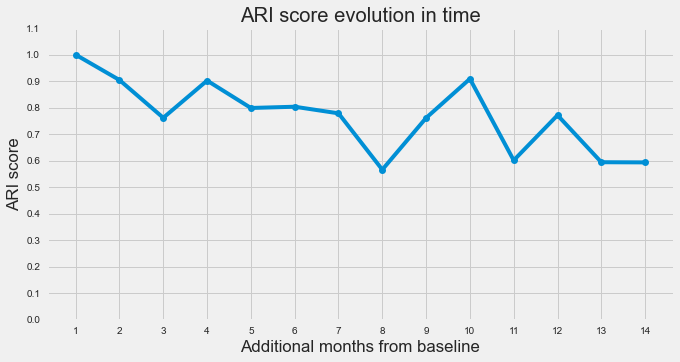

In [52]:
f, ax = plt.subplots(figsize=(10, 5))
ax.plot(np.arange(1, len(temp_stab_dict)), [temp_stab_dict[x]['ari_score'] for x in temp_stab_dict if x != 'ref'], marker='o')
ax.set_title('ARI score evolution in time')
ax.set_xlabel('Additional months from baseline')
ax.set_ylabel('ARI score')
ax.set_xticks(np.arange(1, len(temp_stab_dict), 1))
ax.set_yticks(np.arange(0, 1.2, 0.1))
plt.show()

### On RFM features

In [53]:
kmeans_rfm_pipe = Pipeline([
    ('preprocessor', StandardScaler()),
    ('clusterer', KMeans(**kmeans_params))
])

In [54]:
df_rfm_kmeans = df[['recency', 'total_paid', 'nb_orders']].copy()

#### Optimal number of clusters

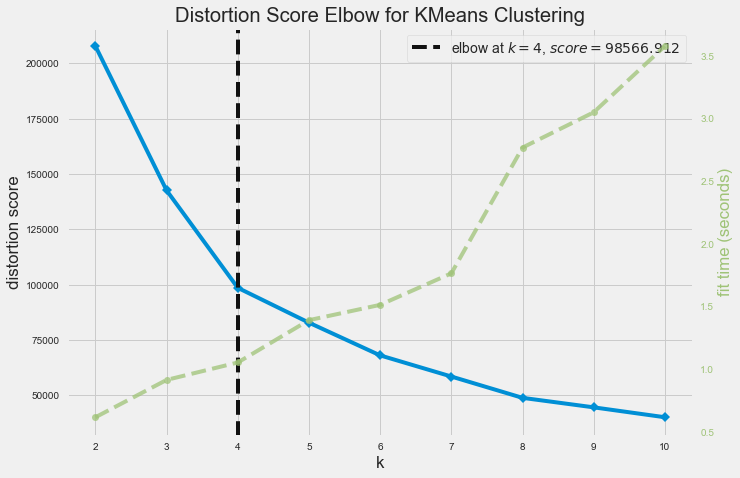

In [55]:
k_range = (2, 11)
display_elbow_visu(kmeans_rfm_pipe, df_rfm_kmeans, k_range, 'distortion')

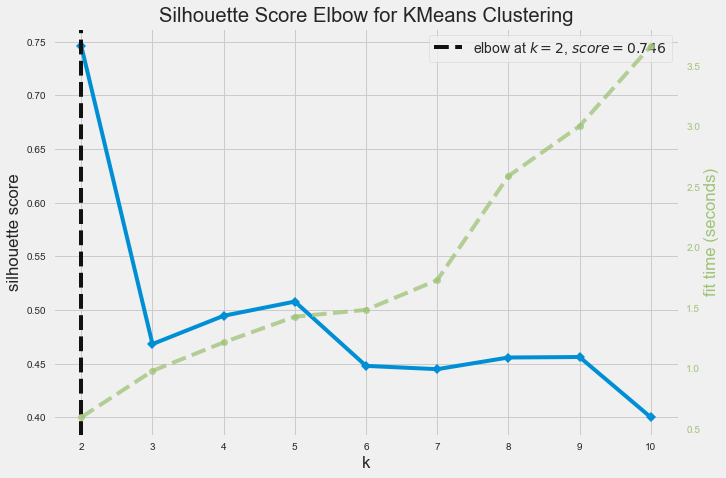

In [56]:
display_elbow_visu(kmeans_rfm_pipe, df_rfm_kmeans, k_range, 'silhouette')

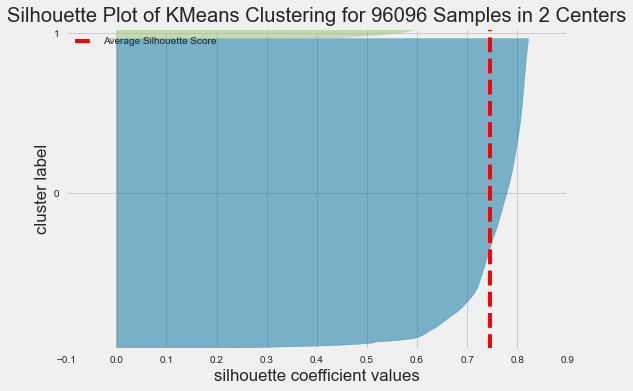

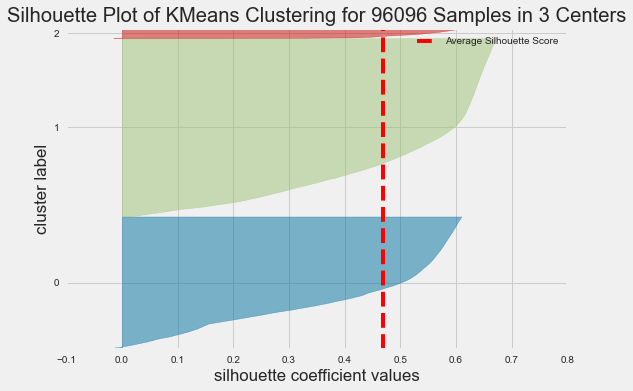

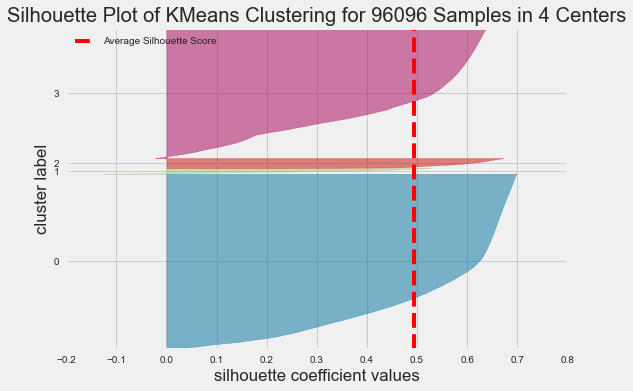

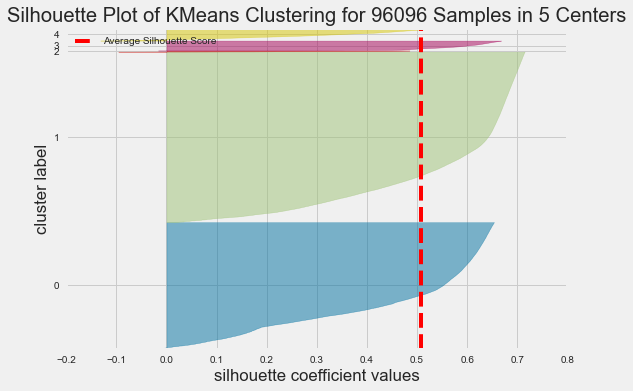

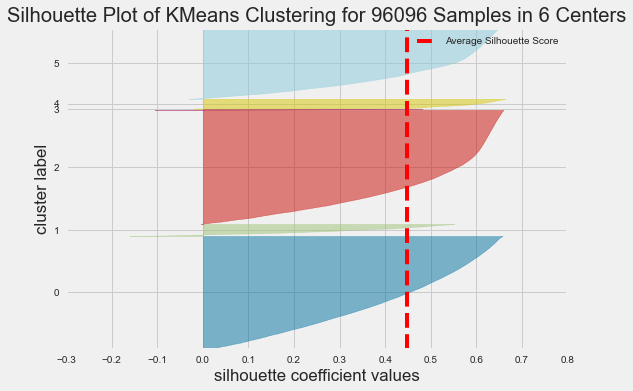

2 clusters - Average silhouette score : 0.7457834488929926
3 clusters - Average silhouette score : 0.4682640800084163
4 clusters - Average silhouette score : 0.4946016832024893
5 clusters - Average silhouette score : 0.5078157257461013
6 clusters - Average silhouette score : 0.44793595740397946


In [57]:
kmeans_rfm_scores = silouhette_analysis(kmeans_rfm_pipe, df_rfm_kmeans, (2, 7))

In [58]:
kmeans_rfm_pipe['clusterer'].n_clusters = 3

#### Visualizations

In [59]:
kmeans_rfm_pipe.fit(df_rfm_kmeans)

Pipeline(steps=[('preprocessor', StandardScaler()),
                ('clusterer', KMeans(n_clusters=3, random_state=1))])

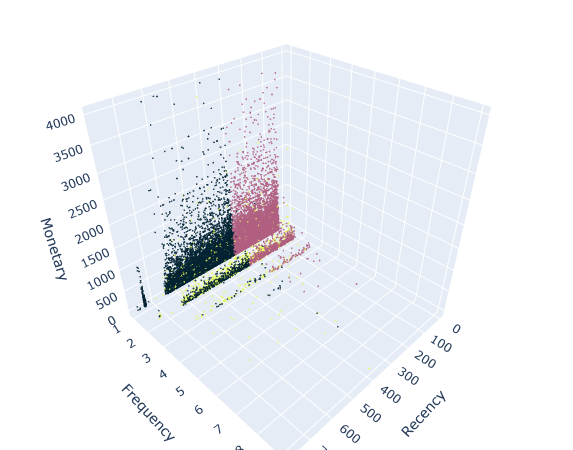

In [60]:
df_rfm_kmeans_labels = df_rfm_kmeans.copy()
df_rfm_kmeans_labels['predicted_label'] = kmeans_rfm_pipe['clusterer'].labels_
rfm_iso_scatter(df_rfm_kmeans_labels, 'recency', 'nb_orders', 'total_paid', color='predicted_label', reduce=True)

Wall time: 10min 2s


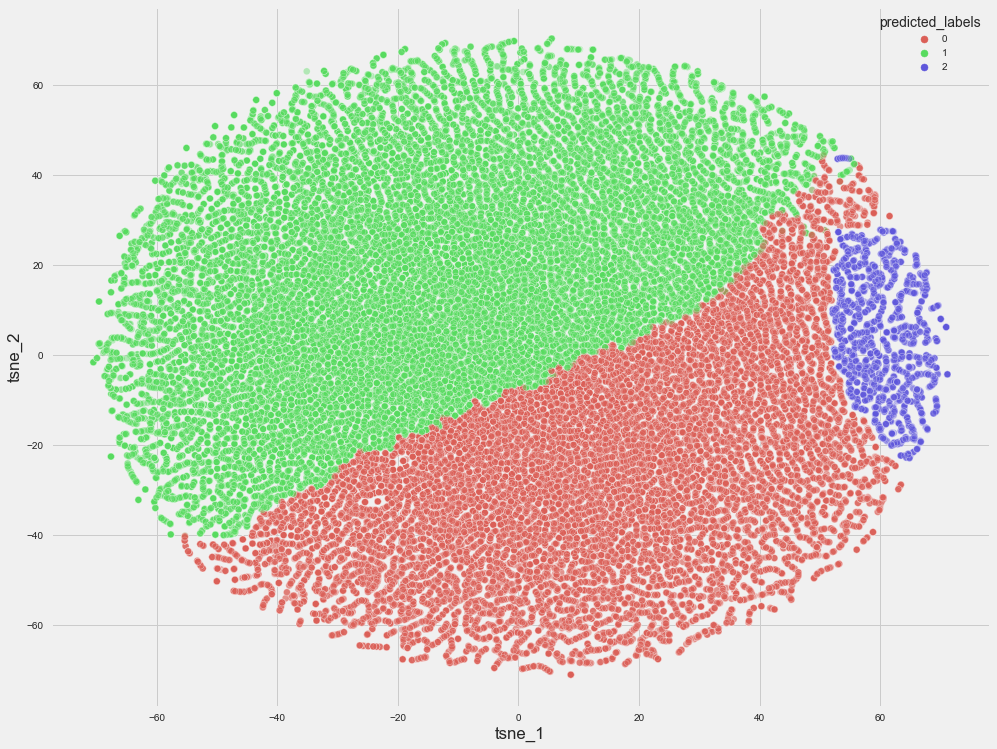

In [61]:
%%time
tsne_visualization(kmeans_rfm_pipe['preprocessor'].transform(df_rfm_kmeans), kmeans_rfm_pipe['clusterer'].labels_, tsne_params)

#### Clusters interpretation

recency       4.000000
total_paid    0.079711
nb_orders     0.000000
Name: 0, dtype: float64


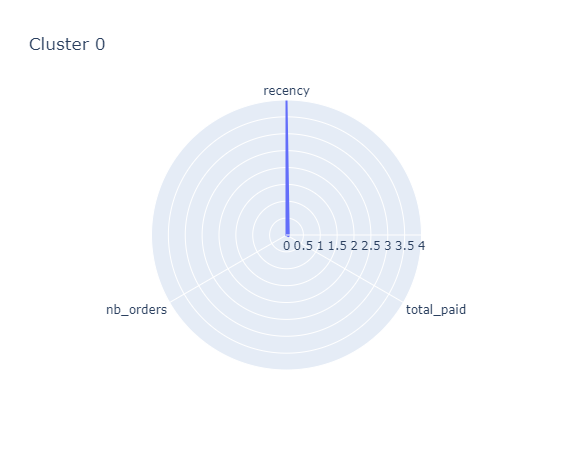

recency       0.0
total_paid    0.0
nb_orders     0.0
Name: 1, dtype: float64


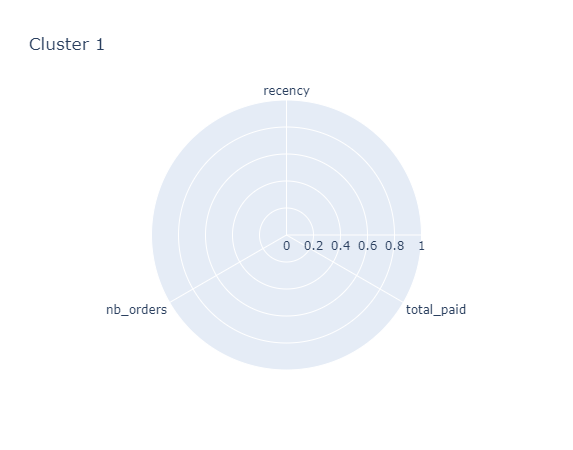

recency       2.734885
total_paid    4.000000
nb_orders     4.000000
Name: 2, dtype: float64


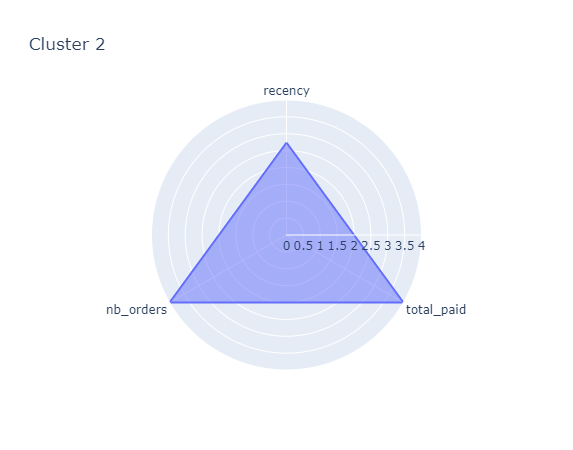

In [62]:
clusters_descr_rfm = clustering_interpretations(df_rfm_kmeans_labels, (0, 4))

In [63]:
clusters_label_rfm = {
    0: 'Lost customers, low spenders',
    1: 'New customers, low spenders',
    2: 'Best customers, loyalists'
}
df_rfm_kmeans_labels['cluster_interpretation'] = df_rfm_kmeans_labels['predicted_label'].apply(lambda x: clusters_label_rfm[x])

In [64]:
df_recap_kmeans_rfm = df_rfm_kmeans_labels.reset_index().groupby('predicted_label').agg(
    Count=('customer_unique_id', 'count'),
    Recency=('recency', 'mean'),
    Frequency=('nb_orders', 'mean'),
    Monetary=('total_paid', 'mean'),
    ClusterInterpretation=('cluster_interpretation', 'unique')
).round(1)
df_recap_kmeans_rfm

,Count,Recency,Frequency,Monetary,ClusterInterpretation
predicted_label,,,,,
0,39648,437.8,1.0,144.6,"[Lost customers, low spenders]"
1,53430,177.4,1.0,140.6,"[New customers, low spenders]"
2,3018,355.5,2.1,341.6,"[Best customers, loyalists]"


#### Initialization stability

Test 1 - ARI : 0.9991118336779187
Test 2 - ARI : 0.9993136590707142
Test 3 - ARI : 1.0
Test 4 - ARI : 1.0
Test 5 - ARI : 0.9994751280003796
Test 6 - ARI : 1.0
Test 7 - ARI : 0.9985468508219437
Test 8 - ARI : 1.0
Test 9 - ARI : 0.9958050152544347
Test 10 - ARI : 1.0


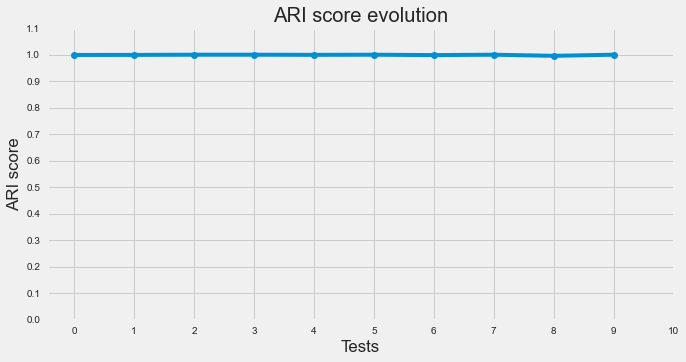

In [65]:
tested_models = test_init_stability(kmeans_rfm_pipe, df_rfm_kmeans, 10)
f, ax = plt.subplots(figsize=(10, 5))
ax.plot(np.arange(0, len(tested_models)), [tested_models[x]['ari_score'] for x in tested_models], marker='o')
ax.set_title('ARI score evolution')
ax.set_xlabel('Tests')
ax.set_ylabel('ARI score')
ax.set_xticks(np.arange(0, len(tested_models)+1, 1))
ax.set_yticks(np.arange(0, 1.2, 0.1))
plt.show()

#### Temporal stability

In [66]:
temp_stab_dict_rfm = test_temporal_stability(kmeans_rfm_pipe, db_df, random_state=15, rfm=True)

Ref data: 23138 rows
Ref data + 1 months (27351 rows): ARI = 0.9311013419079108 
Ref data + 2 months (31696 rows): ARI = 0.9216624447470936 
Ref data + 3 months (39503 rows): ARI = 0.9581665424883873 
Ref data + 4 months (44731 rows): ARI = 0.9737061944326416 
Ref data + 5 months (51820 rows): ARI = 0.9717156277394312 
Ref data + 6 months (58414 rows): ARI = 0.9651604717088874 
Ref data + 7 months (65411 rows): ARI = 0.9506833385548962 
Ref data + 8 months (72234 rows): ARI = 0.928055199146512 
Ref data + 9 months (78486 rows): ARI = 0.9145227066767818 
Ref data + 10 months (84520 rows): ARI = 0.9065184933844889 
Ref data + 11 months (90911 rows): ARI = 0.9023713017156147 
Ref data + 12 months (96091 rows): ARI = 0.918176895360862 
Ref data + 13 months (96095 rows): ARI = 0.9183378844116086 
Ref data + 14 months (96096 rows): ARI = 0.9136751509997447 


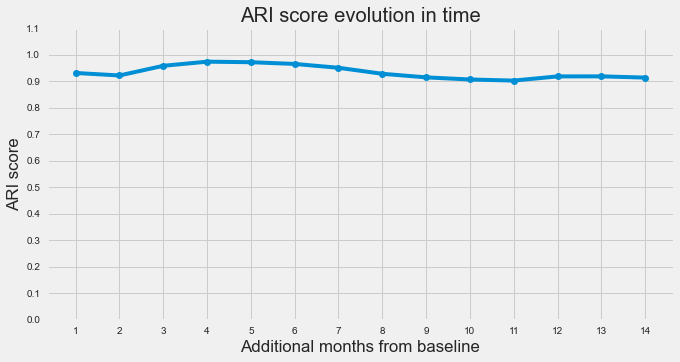

In [67]:
f, ax = plt.subplots(figsize=(10, 5))
ax.plot(np.arange(1, len(temp_stab_dict_rfm)), [temp_stab_dict_rfm[x]['ari_score'] for x in temp_stab_dict_rfm if x != 'ref'], marker='o')
ax.set_title('ARI score evolution in time')
ax.set_xlabel('Additional months from baseline')
ax.set_ylabel('ARI score')
ax.set_xticks(np.arange(1, len(temp_stab_dict_rfm), 1))
ax.set_yticks(np.arange(0, 1.2, 0.1))
plt.show()

## Gaussian Mixture Model

https://towardsdatascience.com/gaussian-mixture-models-vs-k-means-which-one-to-choose-62f2736025f0

### Clustering

In [68]:
gmm_params = {
    'n_components': kmeans_pipe['clusterer'].n_clusters,
    'max_iter': 1000,
    'tol': 1e-4,
    'init_params': 'kmeans',
    'random_state': 1
}

gmm_pipe = Pipeline([
    ('preprocessor', preprocessor),
    ('clusterer', GaussianMixture(**gmm_params))
])

gmm_pipe.fit(df)
preprocessed_data_gmm = gmm_pipe['preprocessor'].transform(df)
predicted_labels_gmm = gmm_pipe['clusterer'].predict(preprocessed_data_gmm)

print('Nb iterations to converge: ', gmm_pipe['clusterer'].n_iter_)
print('Silouhette score:', silhouette_score(preprocessed_data_gmm, predicted_labels_gmm))

Nb iterations to converge:  3
Silouhette score: 0.13541053658082636


In [69]:
kmeans_pipe.fit(df)
print(f"Comparison with kmeans predictions : ARI={adjusted_rand_score(kmeans_pipe['clusterer'].labels_, predicted_labels_gmm)}")

Comparison with kmeans predictions : ARI=0.7662005490616619


### Visualizations

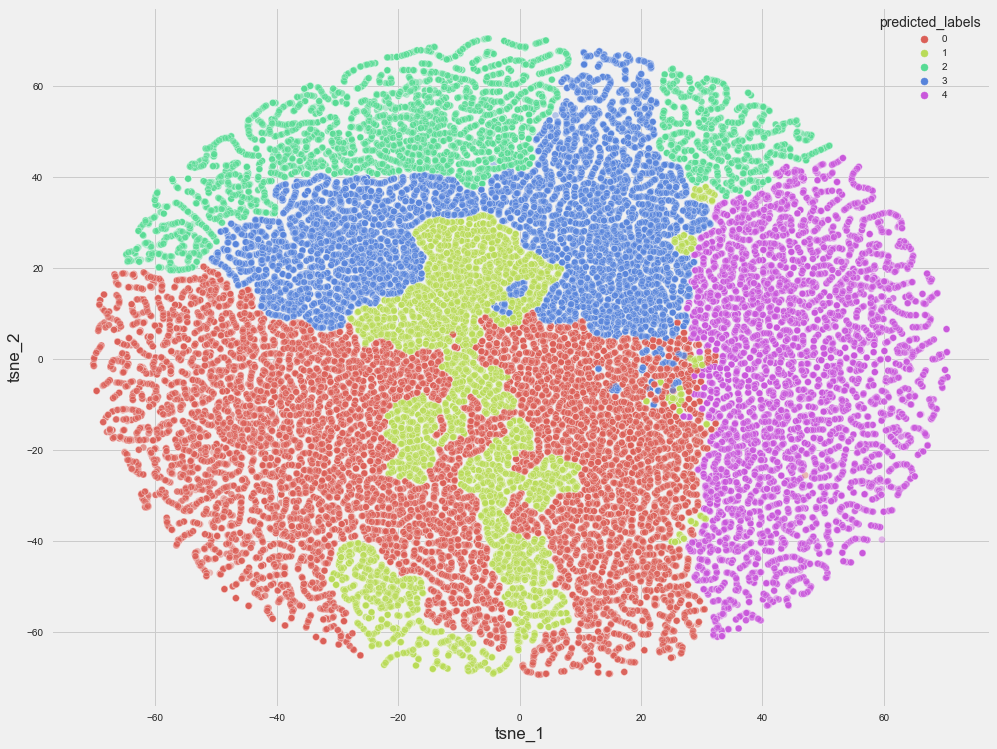

In [70]:
tsne_visualization(preprocessed_data_gmm, predicted_labels_gmm, tsne_params)

nb_orders                            35.987374
total_products_ordered               33.792541
total_paid                          100.000000
mean_photo_qty_for_ordered_prods     36.475457
mean_reviews_score                    0.000000
mean_reviews_txt_length             100.000000
recency                              54.974211
mean_delivery_time                  100.000000
Name: 0, dtype: float64


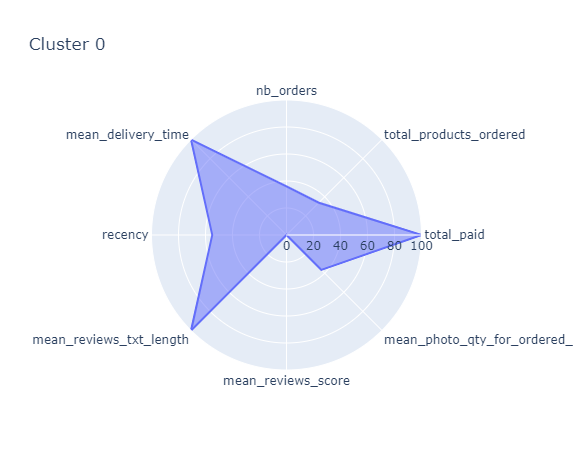

nb_orders                             0.000000
total_products_ordered                0.000000
total_paid                           86.244173
mean_photo_qty_for_ordered_prods    100.000000
mean_reviews_score                  100.000000
mean_reviews_txt_length               0.000000
recency                             100.000000
mean_delivery_time                   51.063039
Name: 1, dtype: float64


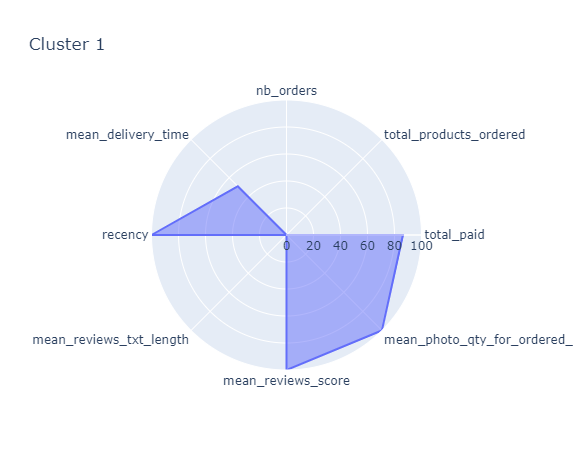

nb_orders                           100.000000
total_products_ordered              100.000000
total_paid                            0.000000
mean_photo_qty_for_ordered_prods      0.000000
mean_reviews_score                   76.931367
mean_reviews_txt_length              36.982039
recency                              44.526440
mean_delivery_time                   10.866485
Name: 2, dtype: float64


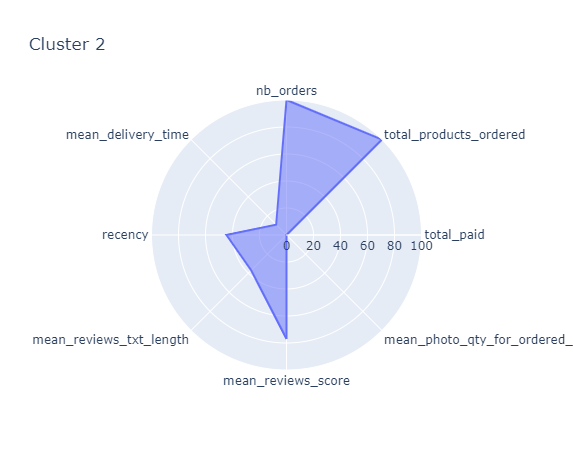

nb_orders                           56.212892
total_products_ordered              19.199336
total_paid                          58.170602
mean_photo_qty_for_ordered_prods    37.972309
mean_reviews_score                  90.596240
mean_reviews_txt_length             35.596053
recency                              0.000000
mean_delivery_time                   0.000000
Name: 3, dtype: float64


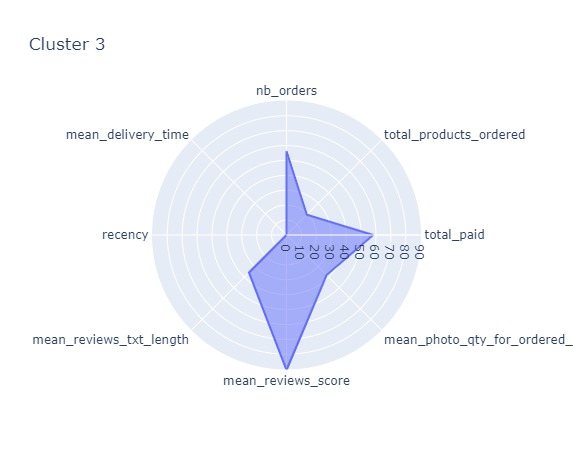

nb_orders                           73.442119
total_products_ordered              45.620180
total_paid                          15.746082
mean_photo_qty_for_ordered_prods    52.273728
mean_reviews_score                  45.547752
mean_reviews_txt_length             46.172542
recency                             81.017750
mean_delivery_time                  79.173032
Name: 4, dtype: float64


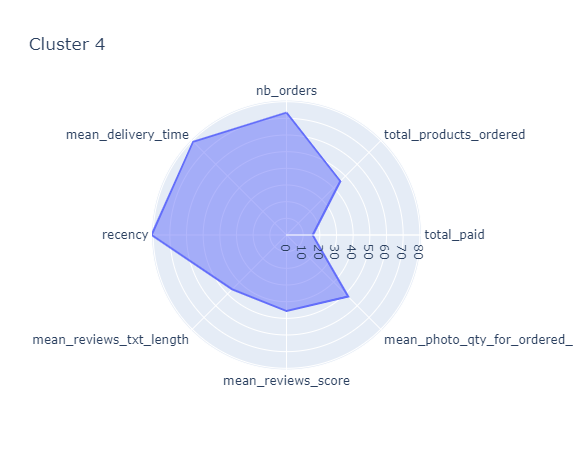

,nb_orders,total_products_ordered,total_paid,mean_photo_qty_for_ordered_prods,mean_reviews_score,mean_reviews_txt_length,recency,mean_delivery_time
0,35.987374,33.792541,100.000000,36.475457,0.000000,100.000000,54.974211,100.000000
1,0.000000,0.000000,86.244173,100.000000,100.000000,0.000000,100.000000,51.063039
2,100.000000,100.000000,0.000000,0.000000,76.931367,36.982039,44.526440,10.866485
3,56.212892,19.199336,58.170602,37.972309,90.596240,35.596053,0.000000,0.000000
4,73.442119,45.620180,15.746082,52.273728,45.547752,46.172542,81.017750,79.173032


In [71]:
df_labels_gmm = df.copy()
df_labels_gmm['predicted_label'] = predicted_labels_gmm
clustering_interpretations(df_labels_gmm)

In [74]:
clusters_label_gmm = {
    4: 'few expensive orders, not happy (bad scores + long reviews)',
    2: 'loyalists, low spenders',
    3: 'happy clients, potential loyalist',
    1: 'Good clients, spend more than average, good reviws scores, not very loyal, attentive to the products photos',
    0: 'Best clients, high spenders, long reviews, not affraid of delivery time'
}
df_labels_gmm['cluster_interpretation'] = df_labels['predicted_label'].apply(lambda x: clusters_label_gmm[x])

In [75]:
df_recap_gmm = df_labels_gmm.reset_index().groupby('predicted_label').agg(
    Count=('customer_unique_id', 'count'),
    Orders=('nb_orders', 'mean'),
    Products=('total_products_ordered', 'mean'),
    PhotosQty=('mean_photo_qty_for_ordered_prods', 'mean'),
    ReviewsScore=('mean_reviews_score', 'mean'),
    RewiewsLength=('mean_reviews_txt_length', 'mean'),
    Recency=('recency', 'mean'),
    DeliveryTime=('mean_delivery_time', 'mean'),
    ClusterInterpretation=('cluster_interpretation', 'unique')
).round(1)
df_recap_gmm

,Count,Orders,Products,PhotosQty,ReviewsScore,RewiewsLength,Recency,DeliveryTime,ClusterInterpretation
predicted_label,,,,,,,,,
0,36287,1.0,1.2,2.2,4.0,32.6,290.6,14.4,"[few expensive orders, not happy (bad scores +..."
1,13987,1.0,1.1,2.4,4.2,28.3,308.2,11.1,"[happy clients, potential loyalist]"
2,9903,1.0,1.3,2.1,4.1,29.9,286.5,8.4,"[Good clients, spend more than average, good r..."
3,18474,1.0,1.1,2.2,4.2,29.8,269.1,7.7,"[loyalists, low spenders]"
4,17445,1.0,1.2,2.2,4.1,30.3,300.8,13.0,"[Best clients, high spenders, long reviews, no..."
